# Read The Dataset

In [ ]:
!pip install --upgrade google-colab

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 4.5 MB/s eta 0:00:00


In [ ]:
!pip install PyDrive

In [ ]:
import os
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [ ]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import scipy.io as sio
import math
from pathlib import Path
import pickle

import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Define the path to the parent directory containing the class folders
train_folder = "/content/drive/MyDrive/archive(2)/Train/Train"

# Define the class names
classes = ["Healthy", "Powdery", "Rust"]

# Data Exploration

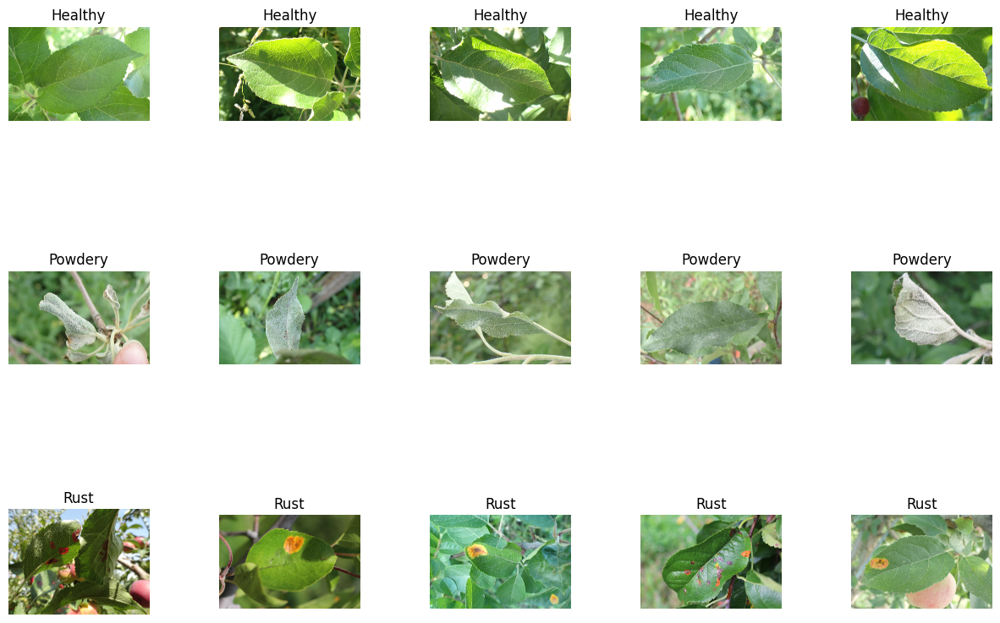

In [ ]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

train_folder = "/content/drive/MyDrive/archive(2)/Train/Train"

# Define the class names
classes = ["Healthy", "Powdery", "Rust"]

# Function to visualize random samples from each class
def visualize_dataset(train_folder, classes, num_samples=5):
    # Create subplots
    fig, axs = plt.subplots(len(classes), num_samples, figsize=(15, 10))
    fig.subplots_adjust(hspace=0.5, wspace=0.5)

    # Iterate over each class
    for i, class_name in enumerate(classes):
        class_dir = os.path.join(train_folder, class_name)
        class_images = os.listdir(class_dir)
        # Select random samples
        random_samples = random.sample(class_images, num_samples)

        # Load and plot the images
        for j, image_name in enumerate(random_samples):
            image_path = os.path.join(class_dir, image_name)
            image = Image.open(image_path)
            axs[i, j].imshow(image)
            axs[i, j].set_title(f'{class_name}')
            axs[i, j].axis('off')

    plt.show()

# Example usage
classes = ["Healthy", "Powdery", "Rust"]
visualize_dataset(train_folder, classes)

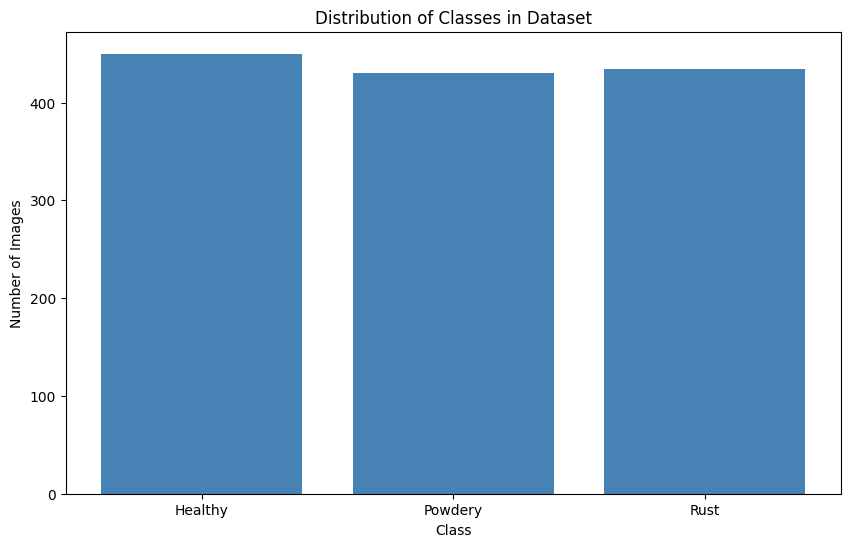

Number of folders (classes) in the dataset: 3
Number of images in each class:
- Healthy: 450
- Powdery: 430
- Rust: 434


In [ ]:
import os
import matplotlib.pyplot as plt

train_folder = "/content/drive/MyDrive/Train_Processed"
# Define the class names
classes = ["Healthy", "Powdery", "Rust"]

# Function to count the number of images in each class
def count_images_per_class(train_folder, classes):
    class_counts = {}
    for class_name in classes:
        class_dir = os.path.join(train_folder, class_name)
        num_images = len(os.listdir(class_dir))
        class_counts[class_name] = num_images
    return class_counts

def count_folders_and_images(train_folder):
    # Initialize counters
    folder_count = 0
    class_image_counts = {}

    # Iterate through directories in the dataset directory
    for root, dirs, files in os.walk(train_folder):
        # Exclude hidden directories (starting with ".")
        dirs[:] = [d for d in dirs if not d.startswith('.')]
        folder_count += len(dirs)

        # Count the number of images in each class
        for d in dirs:
            class_dir = os.path.join(root, d)
            num_images = len([f for f in os.listdir(class_dir) if f.endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp'))])
            class_image_counts[d] = num_images

    return folder_count, class_image_counts
# Function to visualize the number of images per class
def visualize_class_distribution(class_counts):
    plt.figure(figsize=(10, 6))
    plt.bar(class_counts.keys(), class_counts.values(), color='steelblue')
    plt.xlabel('Class')
    plt.ylabel('Number of Images')
    plt.title('Distribution of Classes in Dataset')
    plt.show()

# Example usage
classes = ["Healthy", "Powdery", "Rust"]

class_counts = count_images_per_class(train_folder, classes)
visualize_class_distribution(class_counts)

# Example usage
folder_count, class_image_counts = count_folders_and_images(train_folder)

# Print the number of folders (classes) in the dataset
print("Number of folders (classes) in the dataset:", folder_count)

# Print the number of images in each class
print("Number of images in each class:")
for class_name, num_images in class_image_counts.items():
    print(f"- {class_name}: {num_images}")

In [ ]:
import os
from PIL import Image

def get_image_sizes(train_folder):
    image_sizes = []

    # Iterate through files in the directory
    for root, dirs, files in os.walk(train_folder):
        for file in files:
            # Check if the file is an image
            if file.endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp')):
                file_path = os.path.join(root, file)
                # Open the image and get its size
                with Image.open(file_path) as img:
                    width, height = img.size
                    image_sizes.append((file_path, width, height))

    return image_sizes

# Example usage
image_sizes = get_image_sizes(train_folder)

# Print the sizes of each image
for img_path, width, height in image_sizes:
    print(f"Image: {img_path}, Size: {width}x{height}")

Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/802b59956a7aa5e7.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/809e3fc0cbac7c59.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80aaeaaa275d5e36.jpg, Size: 4000x3000
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80a4c7f6ad9a55d8.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/804e673e9ec3d12b.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/800edef467d27c15.jpg, Size: 4000x3000
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80a13fcd9a4fb14b.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80a5a17f5e48697d.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/803bcb65f486e39a.jpg, Size: 4000x2672
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80aa53172b9fc78d.jpg, Size: 4000x2672
Image: /co

In [ ]:
import os
from PIL import Image

def calculate_aspect_ratios(train_folder):
    aspect_ratios = []

    # Iterate through files in the directory
    for root, dirs, files in os.walk(train_folder):
        for file in files:
            # Check if the file is an image
            if file.endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp')):
                file_path = os.path.join(root, file)
                # Open the image and get its size
                with Image.open(file_path) as img:
                    width, height = img.size
                    # Calculate the aspect ratio
                    aspect_ratio = width / height
                    aspect_ratios.append((file_path, aspect_ratio))

    return aspect_ratios

aspect_ratios = calculate_aspect_ratios(train_folder)

# Print the aspect ratios of each image
for img_path, aspect_ratio in aspect_ratios:
    print(f"Image: {img_path}, Aspect Ratio: {aspect_ratio:.2f}")

Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/802b59956a7aa5e7.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/809e3fc0cbac7c59.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80aaeaaa275d5e36.jpg, Aspect Ratio: 1.33
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80a4c7f6ad9a55d8.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/804e673e9ec3d12b.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/800edef467d27c15.jpg, Aspect Ratio: 1.33
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80a13fcd9a4fb14b.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80a5a17f5e48697d.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/803bcb65f486e39a.jpg, Aspect Ratio: 1.50
Image: /content/drive/MyDrive/archive(2)/Train/Train/Healthy/80aa53172b9fc78d.jpg,

In [ ]:
import os
from PIL import Image

def check_data_quality(dataset_dir):
    # Initialize counters for data quality issues
    num_corrupt_images = 0
    low_resolution_images = 0
    inconsistent_labels = 0

    # Iterate through files in the dataset directory
    for root, dirs, files in os.walk(dataset_dir):
        # Exclude hidden directories (starting with ".")
        dirs[:] = [d for d in dirs if not d.startswith('.')]

        for file in files:
            file_path = os.path.join(root, file)
            try:
                # Check for data corruption
                with Image.open(file_path) as img:
                    img.verify()  # Attempt to open and verify the image file
            except (IOError, SyntaxError) as e:
                num_corrupt_images += 1

            # Check image resolution
            with Image.open(file_path) as img:
                width, height = img.size
                if width < 32 or height < 32:  # Example threshold for low-resolution images
                    low_resolution_images += 1

            # Check for inconsistent labels
            class_name = os.path.basename(root)
            if file.endswith(('.jpg', '.jpeg', '.png', '.gif', '.bmp')) and class_name not in file:
                inconsistent_labels += 1

    return num_corrupt_images, low_resolution_images, inconsistent_labels

# Example usage
dataset_dir = "path/to/your/dataset"
num_corrupt_images, low_resolution_images, inconsistent_labels = check_data_quality(dataset_dir)

# Print data quality issues
print("Data Quality Issues:")
print("Number of corrupt images:", num_corrupt_images)
print("Number of low-resolution images:", low_resolution_images)
print("Number of images with inconsistent labels:", inconsistent_labels)


Data Quality Issues:
Number of corrupt images: 0
Number of low-resolution images: 0
Number of images with inconsistent labels: 0


# **Preprocessing**

Contrast Enhancement

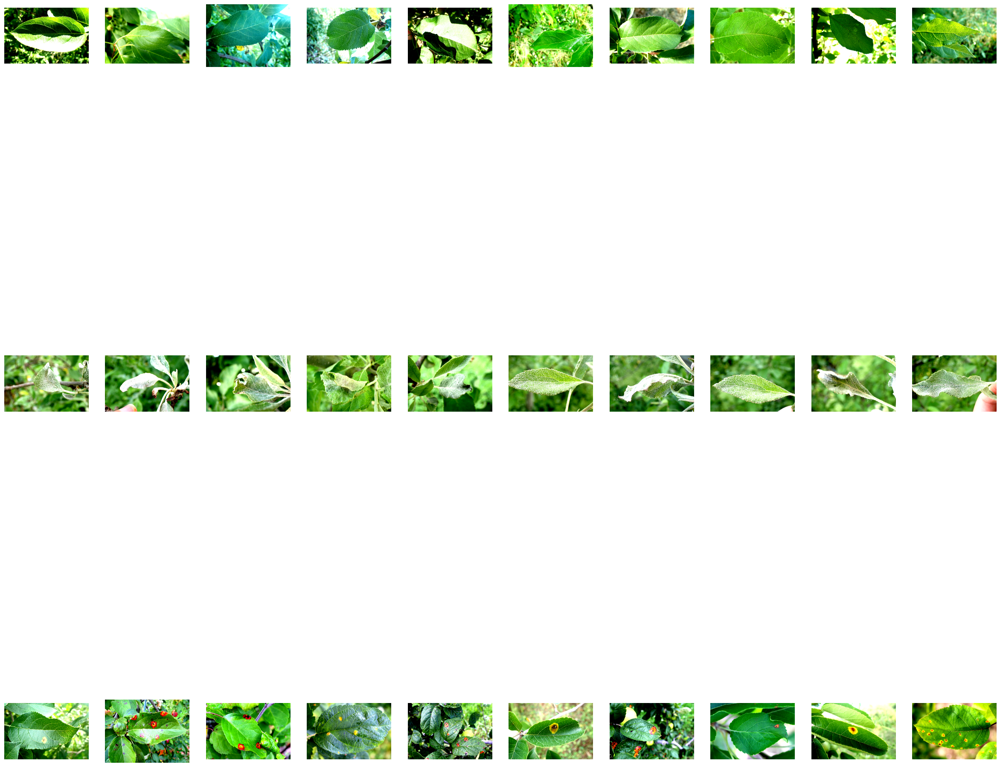

In [ ]:
import matplotlib.pyplot as plt
import os
from PIL import Image, ImageEnhance

# Number of images per class to display
num_images_per_class = 20
num_cols = 10

fig, axes = plt.subplots(nrows=len(classes), ncols=num_cols, figsize=(30, 30))

factor = 2  # Set the contrast factor here

for class_idx, class_name in enumerate(classes):
    class_path = os.path.join(train_folder, class_name)
    image_files = os.listdir(class_path)[:num_images_per_class]

    for i, ax in enumerate(axes[class_idx]):
        if i < len(image_files):
            img = Image.open(os.path.join(class_path, image_files[i]))
            enhancer = ImageEnhance.Contrast(img)
            img_output = enhancer.enhance(factor)
            ax.imshow(img_output)
            ax.axis('off')
        else:
            ax.axis('off')

plt.show()


 Brightness Enhancement

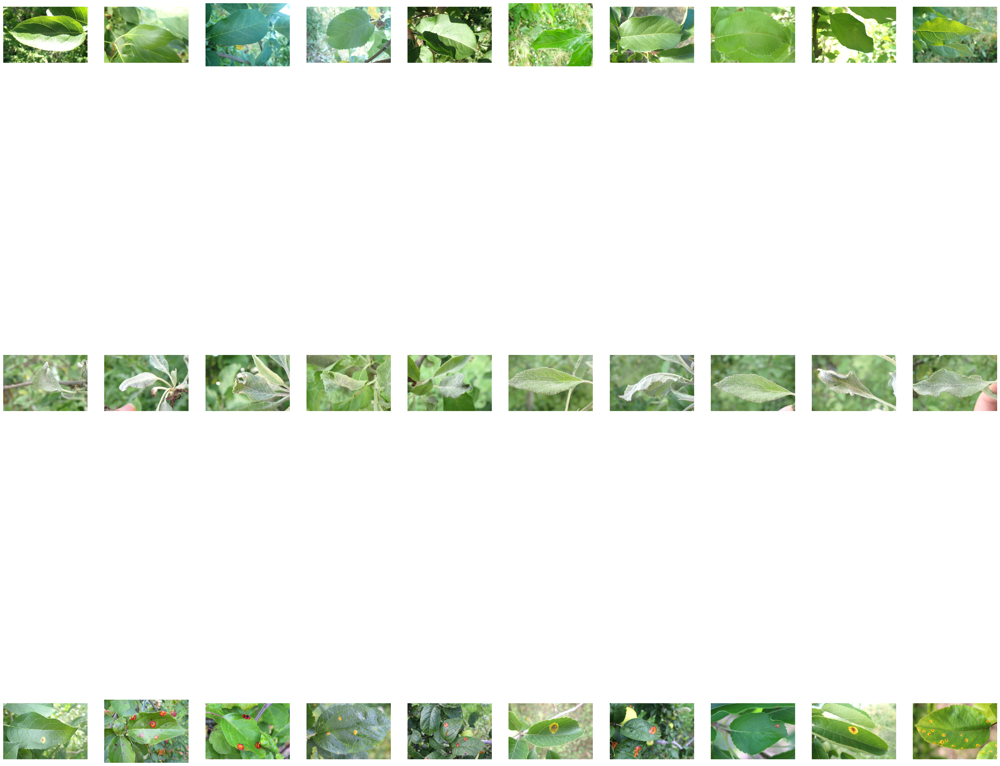

In [ ]:
import matplotlib.pyplot as plt
import cv2
import os

# Number of images per class to display
num_images_per_class = 20
num_cols = 10

fig, axes = plt.subplots(nrows=len(classes), ncols=num_cols, figsize=(40, 40))

brightness_level = 10  # Set the brightness level here

for class_idx, class_name in enumerate(classes):
    class_path = os.path.join(train_folder, class_name)
    image_files = os.listdir(class_path)[:num_images_per_class]

    for i, ax in enumerate(axes[class_idx]):
        if i < len(image_files):
            img = cv2.imread(os.path.join(class_path, image_files[i]))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img_bright = cv2.addWeighted(img, 1 + brightness_level/100, img, 0, 0)
            ax.imshow(img_bright)
            ax.axis('off')
        else:
            ax.axis('off')

plt.show()

Sharpness Enhancement

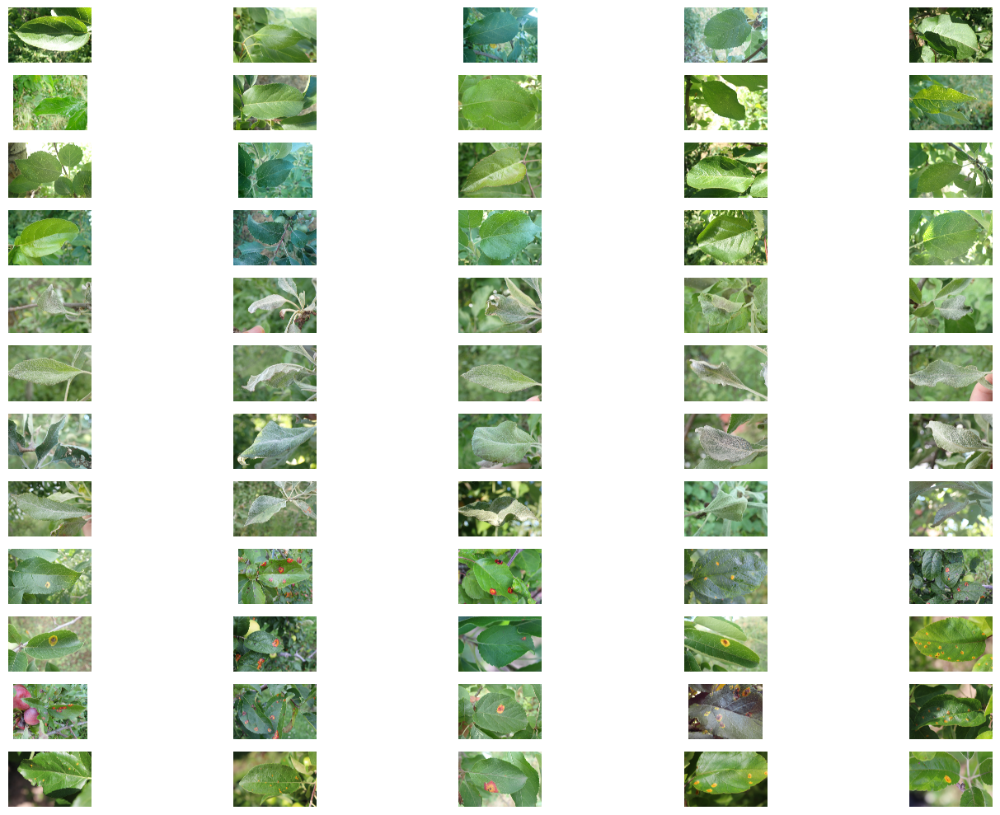

In [ ]:
import os
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt

# Define the maximum number of images to process per class
images_per_class = 20

# Define a function to apply sharpness enhancement to an image
def apply_sharpness_enhancement(image):
    enhancer = ImageEnhance.Sharpness(image)
    enhanced_img = enhancer.enhance(2.0)  # Adjust the enhancement factor (2.0) as needed
    return enhanced_img

# Process images for each class
sharpness_enhanced_images = []
for class_name in classes:
    class_path = os.path.join(train_folder, class_name)
    image_count = 0  # Counter to track the number of processed images per class
    for file_name in os.listdir(class_path):
        if file_name.endswith('.jpg') or file_name.endswith('.png'):
            # Read the image
            img_path = os.path.join(class_path, file_name)
            img = Image.open(img_path)

            # Apply sharpness enhancement
            enhanced_img = apply_sharpness_enhancement(img)
            sharpness_enhanced_images.append(enhanced_img)

            # Increment the image count
            image_count += 1

            # Check if the maximum number of images per class has been reached
            if image_count >= images_per_class:
                break

# Display a sample of sharpness enhanced images
sample_size = len(classes) * images_per_class  # Total number of enhanced images to display
num_columns = 5  # Number of columns for image display
num_rows = sample_size // num_columns + (1 if sample_size % num_columns != 0 else 0)  # Calculate the number of rows

# Show sample sharpness enhanced images
fig, axes = plt.subplots(num_rows, num_columns, figsize=(15, 10))
for i, img in enumerate(sharpness_enhanced_images[:sample_size]):
    row = i // num_columns
    col = i % num_columns
    axes[row, col].imshow(img)
    axes[row, col].axis('off')

# Hide empty subplots
for i in range(sample_size, num_rows * num_columns):
    row = i // num_columns
    col = i % num_columns
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()


# Edge Detection

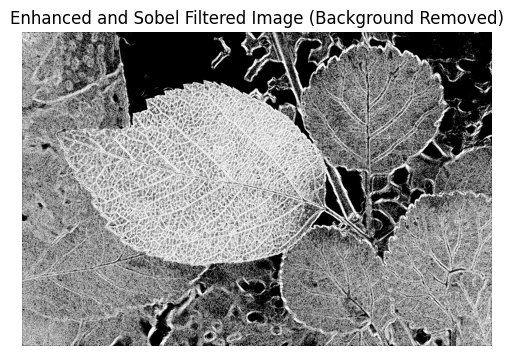

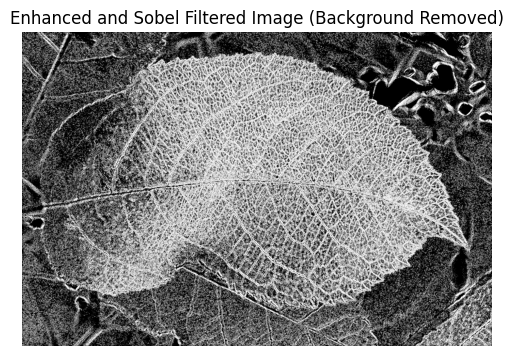

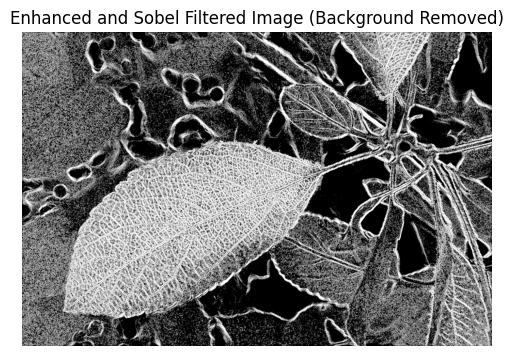

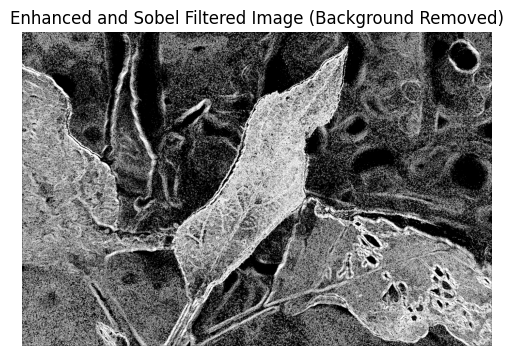

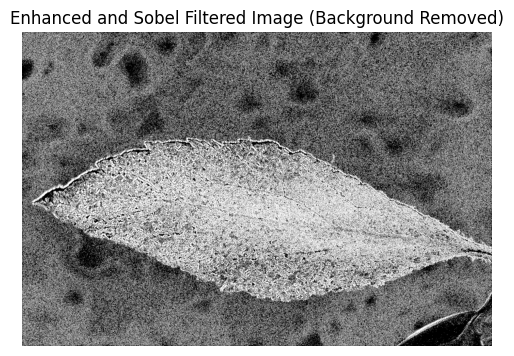

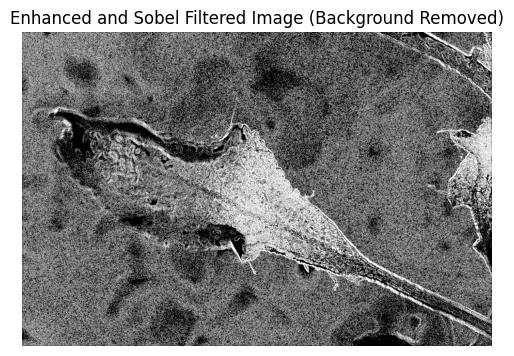

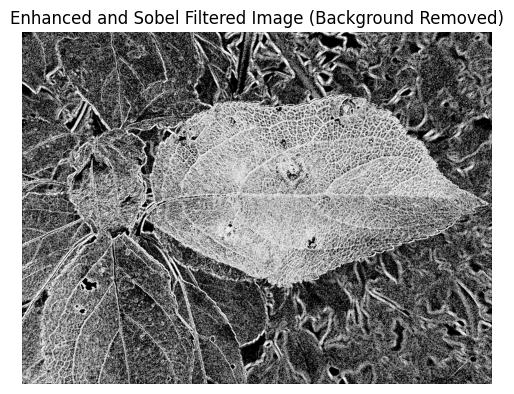

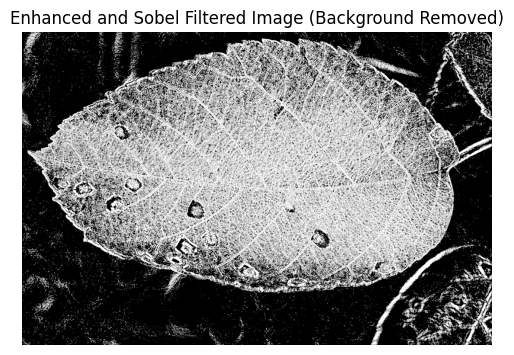

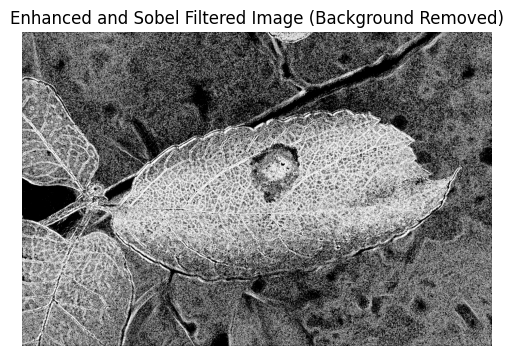

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def apply_filters(image):
    # Apply CLAHE to enhance contrast
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    enhanced = clahe.apply(image)

    # Apply Sobel filter to the enhanced image
    sobel_x = cv2.Sobel(enhanced, cv2.CV_64F, 1, 0, ksize=5)
    sobel_y = cv2.Sobel(enhanced, cv2.CV_64F, 0, 1, ksize=5)
    sobel_x = cv2.convertScaleAbs(sobel_x)
    sobel_y = cv2.convertScaleAbs(sobel_y)
    sobel_combined = cv2.addWeighted(sobel_x, 0.5, sobel_y, 0.5, 0)

    # Apply thresholding to segment foreground (object) from background
    _, thresh = cv2.threshold(sobel_combined, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Remove background by masking with the thresholded image
    result = cv2.bitwise_and(sobel_combined, sobel_combined, mask=thresh)

    return result

def preprocess_images(input_folder, output_folder, num_images):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Counter for processed images
    count = 0

    for filename in os.listdir(input_folder):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            # Read the image
            image = cv2.imread(os.path.join(input_folder, filename), cv2.IMREAD_GRAYSCALE)

            # Apply filters
            combined_image = apply_filters(image)

            # Display the images
            plt.figure(figsize=(5, 5))

            plt.imshow(combined_image, cmap='gray')
            plt.title('Enhanced and Sobel Filtered Image (Background Removed)')
            plt.axis('off')

            plt.tight_layout()
            plt.show()

            # Save the combined image
            cv2.imwrite(os.path.join(output_folder, f"combined_{filename}"), combined_image)

            # Increment counter
            count += 1

            # Check if reached desired number of images
            if count == num_images:
                break

# Path to your dataset folders
healthy_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Healthy"
powdery_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Powdery"
rust_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Rust"

# Number of images to process for each category
num_images = 3  # Change this to your desired number

# Preprocess images for each category
preprocess_images(healthy_folder, "/content/drive/MyDrive/Train_Processed/Healthy", num_images)
preprocess_images(powdery_folder, "/content/drive/MyDrive/Train_Processed/Powdery", num_images)
preprocess_images(rust_folder, "/content/drive/MyDrive/Train_Processed/Rust", num_images)


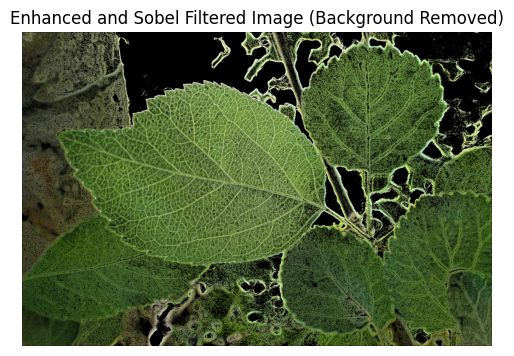

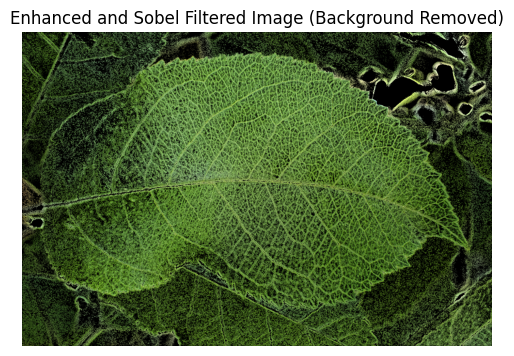

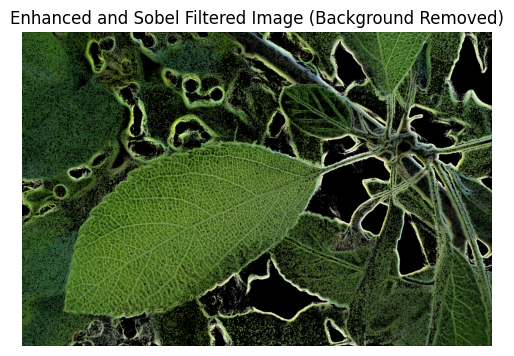

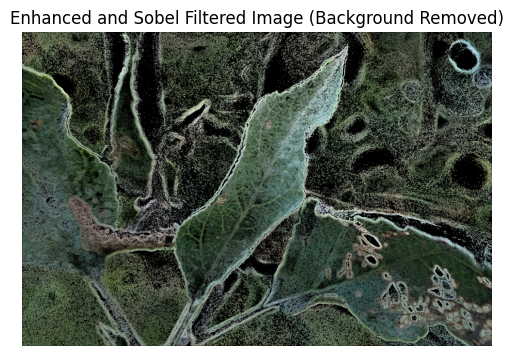

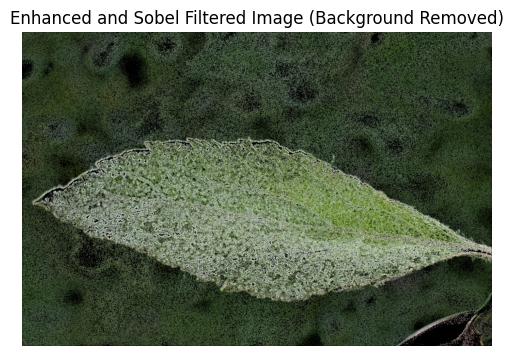

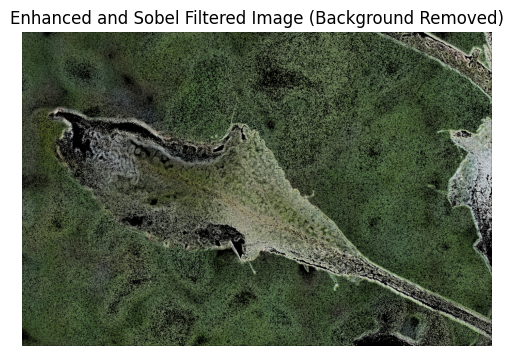

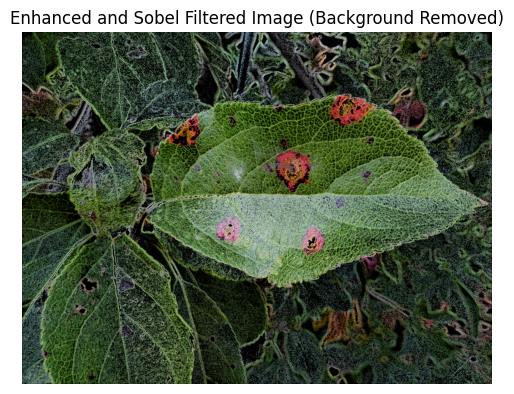

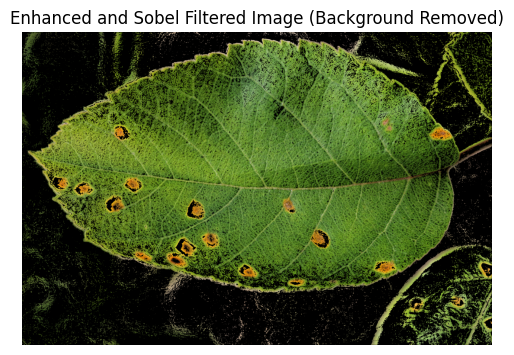

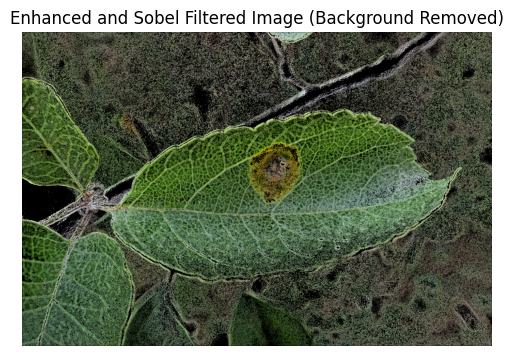

In [ ]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def apply_filters(image):
    # Convert image to LAB color space
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)

    # Split LAB image into channels
    l, a, b = cv2.split(lab)

    # Apply CLAHE to enhance contrast on the L channel
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    l_enhanced = clahe.apply(l)

    # Merge enhanced L channel with original A and B channels
    lab_enhanced = cv2.merge((l_enhanced, a, b))

    # Convert back to BGR color space
    enhanced = cv2.cvtColor(lab_enhanced, cv2.COLOR_LAB2BGR)

    # Apply Sobel filter to the enhanced image
    sobel_x = cv2.Sobel(enhanced, cv2.CV_64F, 1, 0, ksize=5)
    sobel_y = cv2.Sobel(enhanced, cv2.CV_64F, 0, 1, ksize=5)
    sobel_x = cv2.convertScaleAbs(sobel_x)
    sobel_y = cv2.convertScaleAbs(sobel_y)
    sobel_combined = cv2.addWeighted(sobel_x, 0.5, sobel_y, 0.5, 0)

    # Convert the result to grayscale
    sobel_combined_gray = cv2.cvtColor(sobel_combined, cv2.COLOR_BGR2GRAY)

    # Apply thresholding to segment foreground (object) from background
    _, thresh = cv2.threshold(sobel_combined_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Remove background by masking with the thresholded image
    result = cv2.bitwise_and(image, image, mask=thresh)

    return result

def preprocess_images(input_folder, output_folder, num_images):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Counter for processed images
    count = 0

    for filename in os.listdir(input_folder):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            # Read the image
            image = cv2.imread(os.path.join(input_folder, filename))

            # Apply filters
            combined_image = apply_filters(image)

            # Display the images
            plt.figure(figsize=(5, 5))

            plt.imshow(cv2.cvtColor(combined_image, cv2.COLOR_BGR2RGB))
            plt.title('Enhanced and Sobel Filtered Image (Background Removed)')
            plt.axis('off')

            plt.tight_layout()
            plt.show()

            # Save the combined image
            cv2.imwrite(os.path.join(output_folder, f"combined_{filename}"), combined_image)

            # Increment counter
            count += 1

            # Check if reached desired number of images
            if count == num_images:
                break

# Path to your dataset folders
healthy_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Healthy"
powdery_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Powdery"
rust_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Rust"

# Number of images to process for each category
num_images = 3  # Change this to your desired number

# Preprocess images for each category
preprocess_images(healthy_folder, "/content/drive/MyDrive/Train_Processed/Healthy", num_images)
preprocess_images(powdery_folder, "/content/drive/MyDrive/Train_Processed/Powdery", num_images)
preprocess_images(rust_folder, "/content/drive/MyDrive/Train_Processed/Rust", num_images)


# **Saving Preprocessed Images To New File**

In [ ]:
import cv2
import numpy as np
import os

def apply_filters(image):
    # Convert image to LAB color space
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)

    # Split LAB image into channels
    l, a, b = cv2.split(lab)

    # Apply CLAHE to enhance contrast on the L channel
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    l_enhanced = clahe.apply(l)

    # Merge enhanced L channel with original A and B channels
    lab_enhanced = cv2.merge((l_enhanced, a, b))

    # Convert back to BGR color space
    enhanced = cv2.cvtColor(lab_enhanced, cv2.COLOR_LAB2BGR)

    # Apply Sobel filter to the enhanced image
    sobel_x = cv2.Sobel(enhanced, cv2.CV_64F, 1, 0, ksize=5)
    sobel_y = cv2.Sobel(enhanced, cv2.CV_64F, 0, 1, ksize=5)
    sobel_x = cv2.convertScaleAbs(sobel_x)
    sobel_y = cv2.convertScaleAbs(sobel_y)
    sobel_combined = cv2.addWeighted(sobel_x, 0.5, sobel_y, 0.5, 0)

    # Convert the result to grayscale
    sobel_combined_gray = cv2.cvtColor(sobel_combined, cv2.COLOR_BGR2GRAY)

    # Apply thresholding to segment foreground (object) from background
    _, thresh = cv2.threshold(sobel_combined_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Remove background by masking with the thresholded image
    result = cv2.bitwise_and(image, image, mask=thresh)

    return result

def preprocess_images(input_folder, output_folder, num_images):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Get the class name from the input folder name
    class_name = os.path.basename(input_folder)

    # Create a folder for the class in the output folder
    class_output_folder = os.path.join(output_folder, class_name)
    if not os.path.exists(class_output_folder):
        os.makedirs(class_output_folder)

    # Counter for processed images
    count = 0

    for filename in os.listdir(input_folder):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            # Read the image
            image = cv2.imread(os.path.join(input_folder, filename))

            # Apply filters
            combined_image = apply_filters(image)

            # Save the combined image
            output_filename = f"combined_{filename}"
            output_path = os.path.join(class_output_folder, output_filename)
            cv2.imwrite(output_path, combined_image)

            # Increment counter
            count += 1

            # Check if reached desired number of images
            if count == num_images:
                break

# Path to your dataset folders
healthy_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Healthy"
powdery_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Powdery"
rust_folder = "/content/drive/MyDrive/archive(2)/Train/Train/Rust"

# Output folder path
output_folder = "/content/drive/MyDrive/Train_Processed"

# Number of images to process for each category
num_images = 450  # Change this to your desired number

# Preprocess images for each category
preprocess_images(healthy_folder, output_folder, num_images)
preprocess_images(powdery_folder, output_folder, num_images)
preprocess_images(rust_folder, output_folder, num_images)


# Feature Extraction

ORB

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np

# Path to the directory containing the concatenated images
concatenated_dir = '/content/drive/MyDrive/Train_Processed'

# Get a list of all concatenated image files in the directory
concatenated_files = [file for file in os.listdir(concatenated_dir) if file.endswith('.jpg')]

# Initialize the ORB detector
orb = cv2.ORB_create(nfeatures=1500)

# Loop through each concatenated image file
for concatenated_filename in concatenated_files:
    # Read the concatenated image
    concatenated_img = cv2.imread(os.path.join(concatenated_dir, concatenated_filename), cv2.IMREAD_GRAYSCALE)

    # Split the concatenated image into individual images
    individual_images = []
    height, width = concatenated_img.shape
    num_individual_images = 5  # Assuming 10 individual images concatenated horizontally
    individual_width = width // num_individual_images

    for i in range(num_individual_images):
        start_col = i * individual_width
        end_col = (i + 1) * individual_width
        individual_images.append(concatenated_img[:, start_col:end_col])

    # Loop through each individual image
    for img in individual_images:
        # Detect keypoints and compute descriptors
        keypoints_orb, descriptors = orb.detectAndCompute(img, None)

        print("Number of keypoints detected:", len(keypoints_orb))

        # Draw keypoints on the individual image with unique colors
        img_with_keypoints = cv2.drawKeypoints(img, keypoints_orb, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

        # Display the individual image with keypoints
        plt.imshow(img_with_keypoints)
        plt.axis('off')  # Turn off axis
        plt.show()  # Display the image with keypoints


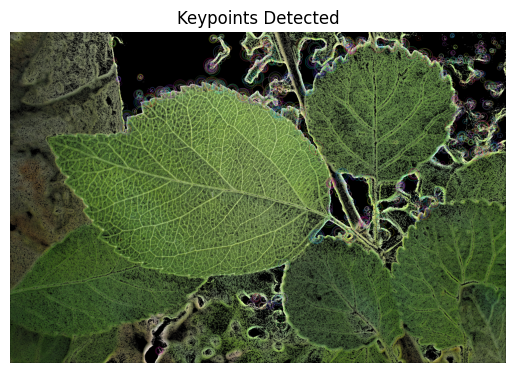

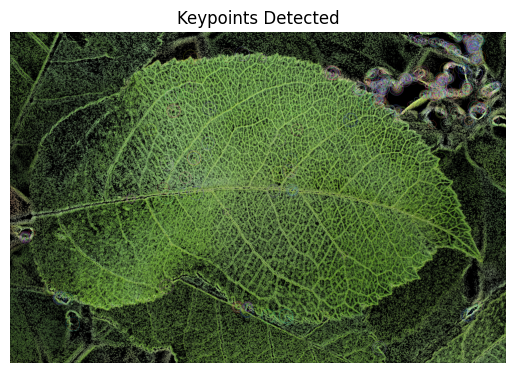

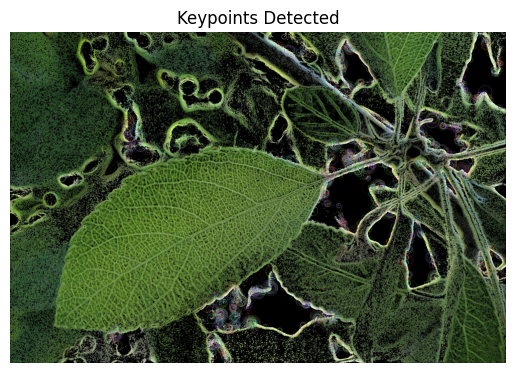

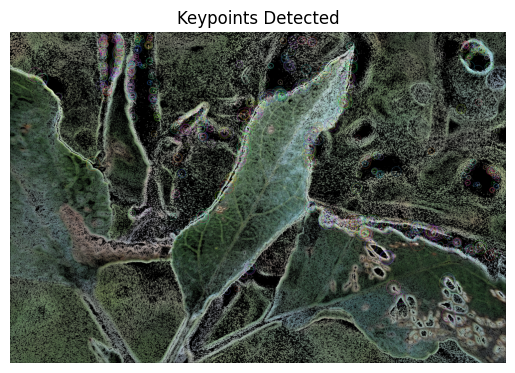

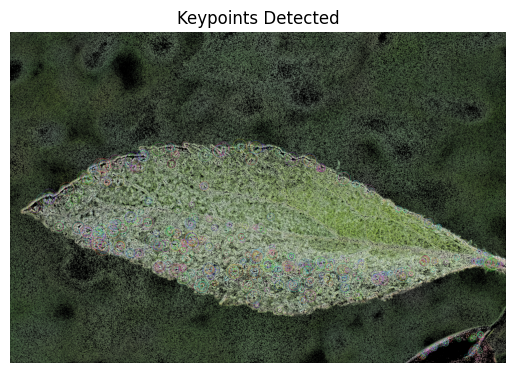

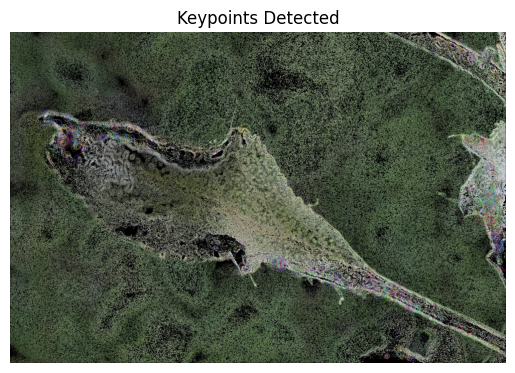

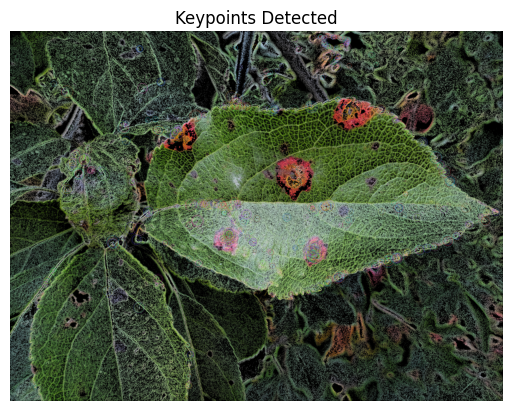

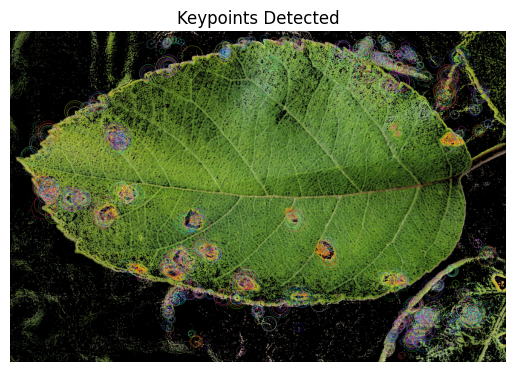

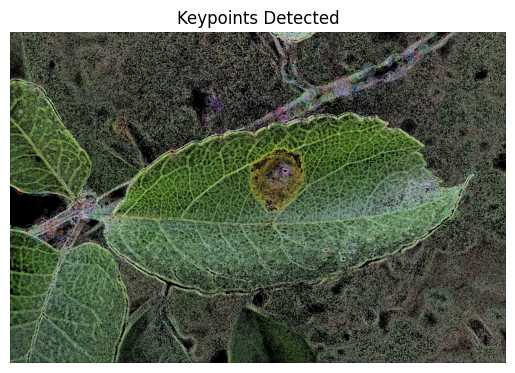

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# Path to the directory containing the dataset
dataset_dir = '/content/drive/MyDrive/Train_Processed'

# Initialize the ORB detector
orb = cv2.ORB_create(nfeatures=1500)

# Lists to store keypoints and descriptors for all images
all_descriptors = []
labels = []

# Loop through each subclass folder
for subclass in os.listdir(dataset_dir):
    subclass_dir = os.path.join(dataset_dir, subclass)

    if os.path.isdir(subclass_dir):
        # Get a list of all image files in the subclass folder
        image_files = [file for file in os.listdir(subclass_dir) if file.endswith('.jpg')]

        # Loop through each image file in the subclass folder
        for filename in image_files[:3]:  # Modify this to visualize keypoints on more images
            # Read the image
            img = cv2.imread(os.path.join(subclass_dir, filename), cv2.IMREAD_COLOR)

            # Convert image to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # Detect keypoints and compute descriptors
            keypoints_orb, descriptors = orb.detectAndCompute(gray_img, None)

            # Draw keypoints on the image
            img_with_keypoints = cv2.drawKeypoints(img, keypoints_orb, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

            # Show the image with keypoints
            plt.imshow(cv2.cvtColor(img_with_keypoints, cv2.COLOR_BGR2RGB))
            plt.title('Keypoints Detected')
            plt.axis('off')
            plt.show()


# **Machine Learning**

Accuracy: 0.6311787072243346
True Label: Rust
Predicted Label: Rust


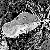


True Label: Powdery
Predicted Label: Powdery


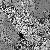


True Label: Rust
Predicted Label: Rust


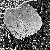


True Label: Powdery
Predicted Label: Powdery


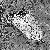


True Label: Healthy
Predicted Label: Powdery


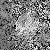


True Label: Healthy
Predicted Label: Healthy


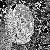


True Label: Powdery
Predicted Label: Rust


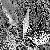


True Label: Healthy
Predicted Label: Healthy


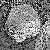


True Label: Powdery
Predicted Label: Healthy


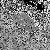


True Label: Powdery
Predicted Label: Healthy


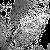


Confusion Matrix:
[[54 20 17]
 [23 55 12]
 [14 11 57]]


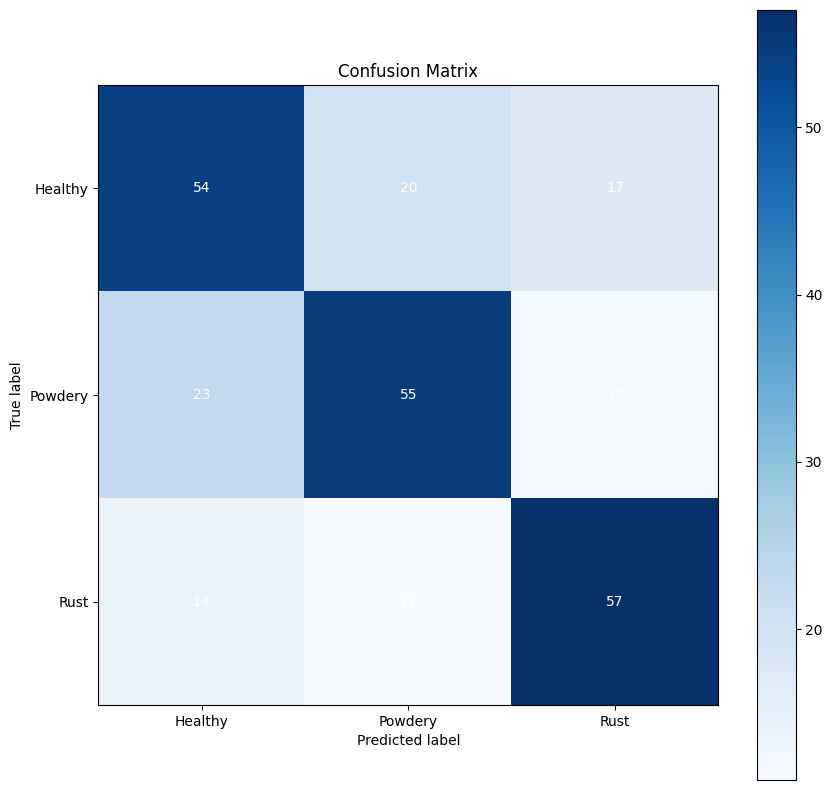

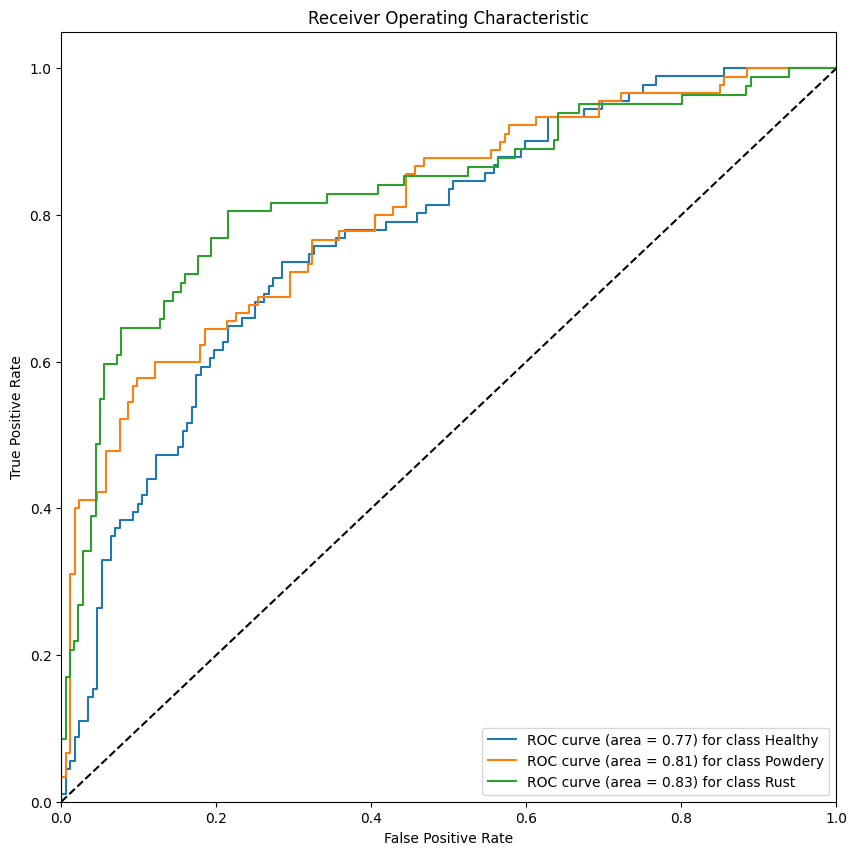

Overall AUC: 0.8035679314811243


In [ ]:
import os
import cv2
import numpy as np
from skimage import exposure
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt

# Define the path to the image dataset
path = '/content/drive/MyDrive/Train_Processed'

# Create a list of image file paths
image_paths = []
for root, dirs, files in os.walk(path):
    for file in files:
        if file.endswith('.jpg'):
            image_paths.append(os.path.join(root, file))

# Define the grayscale, normalization, and standardization functions
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

def normalize(image):
    return exposure.equalize_hist(image, nbins=256, mask=None)

def standardize(image):
    mean = np.mean(image)
    std = np.std(image)
    return (image - mean) / std

# Define the feature extraction function
def extract_features(image):
    # Apply grayscale, normalization, and standardization
    grayscale_image = grayscale(image)
    normalized_image = normalize(grayscale_image)
    standardized_image = standardize(normalized_image)

    # Scale the output to the expected range of [0, 255]
    scaled_image = (standardized_image - np.min(standardized_image)) * 255 / (np.max(standardized_image) - np.min(standardized_image))

    # Resize the image to 50x50
    resized_image = cv2.resize(scaled_image, (50, 50))

    # Flatten the image into a 1D array
    flattened_image = resized_image.flatten()

    return flattened_image

# Extract features from the dataset
X = []
y = []
for image_path in image_paths:
    # Load the image
    image = cv2.imread(image_path)

    # Extract the features and label
    features = extract_features(image)
    label = os.path.basename(os.path.dirname(image_path))

    # Add the features and label to the lists
    X.append(features)
    y.append(label)

# Convert the lists to numpy arrays
X = np.array(X)
y = np.array(y)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Support Vector Classifier (SVC) on the training set
clf = SVC(kernel='linear', probability=True)  # You can change the kernel type here
clf.fit(X_train, y_train)

# Evaluate the model on the testing set
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Show a sample of images with their predictions
sample_size = 10
sample_indices = np.random.choice(len(X_test), sample_size, replace=False)

for i in sample_indices:
    # Get the image and its true label
    image = X_test[i].reshape(50, 50)
    true_label = y_test[i]

    # Get the predicted label from the model
    pred_label = clf.predict(X_test[i].reshape(1, -1))[0]

    # Show the image with its true label and predicted label
    print('True Label:', true_label)
    print('Predicted Label:', pred_label)
    cv2_imshow(image.astype(np.uint8))
    print()  # Print a blank line for spacing

# Calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)
print('Confusion Matrix:')
print(cm)

# Visualize the confusion matrix
fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(cm, cmap='Blues')

# Set the axis labels
ax.set_xticks(np.arange(len(np.unique(y))))
ax.set_yticks(np.arange(len(np.unique(y))))
ax.set_xticklabels(np.unique(y))
ax.set_yticklabels(np.unique(y))

# Set the colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Set the plot title and axis labels
ax.set_title('Confusion Matrix')
ax.set_xlabel('Predicted label')
ax.set_ylabel('True label')

# Loop over the data and add the text labels
for i in range(len(np.unique(y))):
    for j in range(len(np.unique(y))):
        text = ax.text(j, i, cm[i, j], ha='center', va='center', color='w')

# Show the plot
plt.show()

# Calculate the probabilities for the test set (required for ROC curve)
y_prob = clf.predict_proba(X_test)

# Calculate the ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(len(np.unique(y))):
    fpr[i], tpr[i], _ = roc_curve(y_test == np.unique(y)[i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC curve and show the AUC
plt.figure(figsize=(10, 10))
for i in range(len(np.unique(y))):
    plt.plot(fpr[i], tpr[i], label='ROC curve (area = %0.2f) for class %s' % (roc_auc[i], np.unique(y)[i]))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

# Show the overall AUC
print('Overall AUC:', np.mean(list(roc_auc.values())))


In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

print(" SVC Classification Report:")
print(classification_report(y_test, y_pred))

 SVC Classification Report:
              precision    recall  f1-score   support

     Healthy       0.59      0.59      0.59        91
     Powdery       0.64      0.61      0.63        90
        Rust       0.66      0.70      0.68        82

    accuracy                           0.63       263
   macro avg       0.63      0.63      0.63       263
weighted avg       0.63      0.63      0.63       263



In [ ]:
import os
import cv2
import numpy as np
from skimage import exposure
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier  # Import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt

# Define the path to the image dataset
path = '/content/drive/MyDrive/trained_images'

# Create a list of image file paths
image_paths = []
for root, dirs, files in os.walk(path):
    for file in files:
        if file.endswith('.jpg'):
            image_paths.append(os.path.join(root, file))

# Define the grayscale, normalization, and standardization functions
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

def normalize(image):
    return exposure.equalize_hist(image, nbins=256, mask=None)

def standardize(image):
    mean = np.mean(image)
    std = np.std(image)
    return (image - mean) / std

# Define the feature extraction function
def extract_features(image):
    # Apply grayscale, normalization, and standardization
    grayscale_image = grayscale(image)
    normalized_image = normalize(grayscale_image)
    standardized_image = standardize(normalized_image)

    # Scale the output to the expected range of [0, 255]
    scaled_image = (standardized_image - np.min(standardized_image)) * 255 / (np.max(standardized_image) - np.min(standardized_image))

    # Resize the image to 50x50
    resized_image = cv2.resize(scaled_image, (50, 50))

    # Flatten the image into a 1D array
    flattened_image = resized_image.flatten()

    return flattened_image

# Extract features from the dataset
X = []
y = []
for image_path in image_paths:
    # Load the image
    image = cv2.imread(image_path)

    # Extract the features and label
    features = extract_features(image)
    label = os.path.basename(os.path.dirname(image_path))

    # Add the features and label to the lists
    X.append(features)
    y.append(label)

# Convert the lists to numpy arrays
X = np.array(X)
y = np.array(y)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a decision tree classifier on the training set
clf = DecisionTreeClassifier(random_state=42)  # DecisionTreeClassifier
clf.fit(X_train, y_train)

# Evaluate the model on the testing set
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Show a sample of images with their predictions
sample_size = 10
sample_indices = np.random.choice(len(X_test), sample_size, replace=False)

for i in sample_indices:
    # Get the image and its true label
    image = X_test[i].reshape(50, 50)
    true_label = y_test[i]

    # Get the predicted label from the model
    pred_label = clf.predict(X_test[i].reshape(1, -1))[0]

    # Show the image with its true label and predicted label
    print('True Label:', true_label)
    print('Predicted Label:', pred_label)
    cv2_imshow(image.astype(np.uint8))
    print()  # Print a blank line for spacing

# Evaluate the model on the testing set again and print the confusion matrix
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Create the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Print the confusion matrix
print('Confusion Matrix:')
print(cm)

# Visualize the confusion matrix as a heatmap
labels = np.unique(y)
fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(cm, cmap='Blues')
ax.set_xticks(np.arange(len(labels)))
ax.set_yticks(np.arange(len(labels)))
ax.set_xticklabels(labels)
ax.set_yticklabels(labels)
cbar = ax.figure.colorbar(im, ax=ax)
ax.set_title('Confusion Matrix')
ax.set_xlabel('Predicted label')
ax.set_ylabel('True label')
for i in range(len(labels)):
    for j in range(len(labels)):
        text = ax.text(j, i, cm[i, j], ha='center', va='center', color='w')
plt.show()

# Calculate the probabilities for the test set
y_prob = clf.predict_proba(X_test)

# Calculate the ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(len(labels)):
    fpr[i], tpr[i], _ = roc_curve(y_test == labels[i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC curve and show the AUC
plt.figure(figsize=(10, 10))
for i in range(len(labels)):
    plt.plot(fpr[i], tpr[i], label='ROC curve (area = %0.2f) for class %s' % (roc_auc[i], labels[i]))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

# Show the overall AUC
print('Overall AUC:', np.mean(list(roc_auc.values())))


In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

print(" Dicision Tree Classification Report:")
print(classification_report(y_test, y_pred))

In [ ]:
import os
import cv2
import numpy as np
from skimage import exposure
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Define the path to the image dataset
path = '/content/drive/MyDrive/trained_images'

# Create a list of image file paths
image_paths = []
for root, dirs, files in os.walk(path):
    for file in files:
        if file.endswith('.jpg'):
            image_paths.append(os.path.join(root, file))

# Define the grayscale, normalization, and standardization functions
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

def normalize(image):
    return exposure.equalize_hist(image, nbins=256, mask=None)

def standardize(image):
    mean = np.mean(image)
    std = np.std(image)
    return (image - mean) / std

# Define the feature extraction function
def extract_features(image):
    # Apply grayscale, normalization, and standardization
    grayscale_image = grayscale(image)
    normalized_image = normalize(grayscale_image)
    standardized_image = standardize(normalized_image)

    # Scale the output to the expected range of [0, 255]
    scaled_image = (standardized_image - np.min(standardized_image)) * 255 / (np.max(standardized_image) - np.min(standardized_image))

    # Resize the image to 50x50
    resized_image = cv2.resize(scaled_image, (50, 50))

    # Flatten the image into a 1D array
    flattened_image = resized_image.flatten()

    return flattened_image

# Extract features from the dataset
X = []
y = []
for image_path in image_paths:
    # Load the image
    image = cv2.imread(image_path)

    # Extract the features and label
    features = extract_features(image)
    label = os.path.basename(os.path.dirname(image_path))

    # Add the features and label to the lists
    X.append(features)
    y.append(label)

# Convert the lists to numpy arrays
X = np.array(X)
y = np.array(y)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a random forest classifier on the training set
clf = RandomForestClassifier(n_estimators=2000, random_state=42) #n_estimators hyperparameter=100
clf.fit(X_train, y_train)

# Evaluate the model on the testing set
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Show a sample of images with their predictions
sample_size = 10
sample_indices = np.random.choice(len(X_test), sample_size, replace=False)

for i in sample_indices:
    # Get the image and its true label
    image = X_test[i].reshape(50, 50)
    true_label = y_test[i]

    # Get the predicted label from the model
    pred_label = clf.predict(X_test[i].reshape(1, -1))[0]

    # Show the image with its true label and predicted label
    print('True Label:', true_label)
    print('Predicted Label:', pred_label)
    cv2_imshow(image.astype(np.uint8))
    print()  # Print a blank line for spacing


#confusion matrix
from sklearn.metrics import confusion_matrix

# Evaluate the model on the testing set
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Create the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Print the confusion matrix
print('Confusion Matrix:')
print(cm)


#confusion matrix with image
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Get the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Define the labels for the plot
labels = np.unique(y)

# Plot the confusion matrix as a heatmap
fig, ax = plt.subplots(figsize=(10, 10))
im = ax.imshow(cm, cmap='Blues')

# Set the axis labels
ax.set_xticks(np.arange(len(labels)))
ax.set_yticks(np.arange(len(labels)))
ax.set_xticklabels(labels)
ax.set_yticklabels(labels)

# Set the colorbar
cbar = ax.figure.colorbar(im, ax=ax)

# Set the plot title and axis labels
ax.set_title('Confusion Matrix')
ax.set_xlabel('Predicted label')
ax.set_ylabel('True label')

# Loop over the data and add the text labels
for i in range(len(labels)):
    for j in range(len(labels)):
        text = ax.text(j, i, cm[i, j], ha='center', va='center', color='w')

# Show the plot
plt.show()




import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Calculate the probabilities for the test set
y_prob = clf.predict_proba(X_test)

# Calculate the ROC curve and AUC for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(len(labels)):
    fpr[i], tpr[i], _ = roc_curve(y_test == labels[i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot the ROC curve and show the AUC
plt.figure(figsize=(10, 10))
for i in range(len(labels)):
    plt.plot(fpr[i], tpr[i], label='ROC curve (area = %0.2f) for class %s' % (roc_auc[i], labels[i]))
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

# Show the overall AUC
print('Overall AUC:', np.mean(list(roc_auc.values())))



In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

print(" Random Forest Classification Report:")
print(classification_report(y_test, y_pred))

# **Deep Learning Model**

In [ ]:
import pandas as pd
import numpy as np
from collections import defaultdict
from concurrent.futures import ThreadPoolExecutor

# Efficient Looping
import itertools

# Traceback for diagnosis
import traceback

# Data Visualization
import plotly.express as px
import plotly.graph_objs as go
import plotly.subplots as sp
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.io as pio
from IPython.display import display
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

# Statistics & Mathematics
import scipy.stats as stats
import statsmodels.api as sm
from scipy.stats import shapiro, skew, anderson, kstest
import math

# Feature Selection
from sklearn.feature_selection import (
    RFECV, SelectKBest, chi2, f_classif, f_regression,
    mutual_info_classif, mutual_info_regression
)

# Machine Learning Pipeline
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.base import BaseEstimator, TransformerMixin,ClassifierMixin

# Preprocessing data
from sklearn.preprocessing import RobustScaler, StandardScaler, QuantileTransformer, FunctionTransformer

from sklearn.compose import ColumnTransformer
from sklearn.base import BaseEstimator, TransformerMixin

# Model Selection for Cross Validation
from sklearn.model_selection import (
    StratifiedKFold, KFold,
    RepeatedKFold, RepeatedStratifiedKFold,
    train_test_split, TimeSeriesSplit
)

# Machine Learning metrics
from sklearn.metrics import (
    mean_squared_error,
    r2_score,
    mean_absolute_error,
    cohen_kappa_score,
    make_scorer,
    roc_curve,
    auc,
    accuracy_score,
    f1_score,
    precision_score,
    recall_score,
    confusion_matrix
)

# ML regressors
from sklearn.linear_model import HuberRegressor,RANSACRegressor, TheilSenRegressor, Ridge, Lasso, ElasticNet
from sklearn.svm import SVR, NuSVR, LinearSVR
from sklearn.ensemble import (
    HistGradientBoostingRegressor, StackingRegressor,
    AdaBoostRegressor, RandomForestRegressor, ExtraTreesRegressor,
    GradientBoostingRegressor, StackingRegressor, VotingRegressor
    )
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor


# ML classifiers
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.svm import SVC, NuSVC, LinearSVC
from sklearn.ensemble import (
    HistGradientBoostingClassifier, AdaBoostClassifier,
    RandomForestClassifier, GradientBoostingClassifier,
    StackingClassifier, VotingClassifier,ExtraTreesClassifier
    )
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

# Clustering algorithms
from sklearn.cluster import KMeans


# Randomizer
import random

# Encoder of categorical variables
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder

# OS
import os

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras import regularizers

# Image package
from PIL import Image
# Importing Keras
from keras.models import Sequential                          # Neural network model as a sequence of layers.
from keras.layers import Conv2D                              # Convolutional layer
from keras.layers import MaxPooling2D                        # Max pooling layer
from keras.layers import Flatten                             # Layer used to flatten 2D arrays for fully-connected layers.
from keras.layers import Dense                               # This layer adds fully-connected layers to the neural network.
from keras.layers import Dropout                             # This serves to prevent overfitting by dropping out a random set of activations.
from keras.layers import BatchNormalization                  # This is used to normalize the activations of the neurons.
from keras.layers import Activation                          # Layer for activation functions
from keras.callbacks import EarlyStopping, ModelCheckpoint   # Classes used to save weights and stop training when improvements reach a limit
from keras.models import load_model                          # This helps us to load trained models
# Preprocessing layers
from keras.layers import Rescaling                           # This layer rescales pixel values

# Importing TensorFlow
import tensorflow as tf

In [ ]:
train_data_dir = '/content/drive/MyDrive/Train_Processed'
filepaths = []
labels = []

folds = os.listdir(train_data_dir)
for fold in folds:
    foldpath = os.path.join(train_data_dir, fold)
    filelist = os.listdir(foldpath)
    for file in filelist:
        fpath = os.path.join(foldpath, file)

        filepaths.append(fpath)
        labels.append(fold)

# Concatenate data paths with labels into one dataframe
Fseries = pd.Series(filepaths, name= 'filepaths')
Lseries = pd.Series(labels, name='labels')
train_df = pd.concat([Fseries, Lseries], axis= 1)

In [ ]:
train_df

,filepaths,labels
0,/content/drive/MyDrive/Train_Processed/Healthy...,Healthy
1,/content/drive/MyDrive/Train_Processed/Healthy...,Healthy
2,/content/drive/MyDrive/Train_Processed/Healthy...,Healthy
3,/content/drive/MyDrive/Train_Processed/Healthy...,Healthy
4,/content/drive/MyDrive/Train_Processed/Healthy...,Healthy
...,...,...
1309,/content/drive/MyDrive/Train_Processed/Rust/co...,Rust
1310,/content/drive/MyDrive/Train_Processed/Rust/co...,Rust
1311,/content/drive/MyDrive/Train_Processed/Rust/co...,Rust
1312,/content/drive/MyDrive/Train_Processed/Rust/co...,Rust


In [ ]:
# Generate data paths with labels
test_data_dir = '/content/drive/MyDrive/archive(2)/Test/Test'
filepaths = []
labels = []

folds = os.listdir(test_data_dir)
for fold in folds:
    foldpath = os.path.join(test_data_dir, fold)
    filelist = os.listdir(foldpath)
    for file in filelist:
        fpath = os.path.join(foldpath, file)

        filepaths.append(fpath)
        labels.append(fold)

# Concatenate data paths with labels into one dataframe
Fseries = pd.Series(filepaths, name= 'filepaths')
Lseries = pd.Series(labels, name='labels')
ts_df = pd.concat([Fseries, Lseries], axis= 1)

In [ ]:
ts_df

,filepaths,labels
0,/content/drive/MyDrive/archive(2)/Test/Test/He...,Healthy
1,/content/drive/MyDrive/archive(2)/Test/Test/He...,Healthy
2,/content/drive/MyDrive/archive(2)/Test/Test/He...,Healthy
3,/content/drive/MyDrive/archive(2)/Test/Test/He...,Healthy
4,/content/drive/MyDrive/archive(2)/Test/Test/He...,Healthy
...,...,...
145,/content/drive/MyDrive/archive(2)/Test/Test/Ru...,Rust
146,/content/drive/MyDrive/archive(2)/Test/Test/Ru...,Rust
147,/content/drive/MyDrive/archive(2)/Test/Test/Ru...,Rust
148,/content/drive/MyDrive/archive(2)/Test/Test/Ru...,Rust


In [ ]:
valid_df, test_df = train_test_split(ts_df,  train_size= 0.8, random_state= 42)

In [ ]:
batch_size = 8
img_size = (224, 224)
channels = 3
img_shape = (img_size[0], img_size[1], channels)

tr_gen = ImageDataGenerator()
ts_gen = ImageDataGenerator()

train_gen = tr_gen.flow_from_dataframe( train_df, x_col= 'filepaths', y_col= 'labels', target_size= img_size, class_mode= 'categorical',
                                    color_mode= 'rgb', shuffle= True, batch_size= batch_size)

valid_gen = ts_gen.flow_from_dataframe( valid_df, x_col= 'filepaths', y_col= 'labels', target_size= img_size, class_mode= 'categorical',
                                    color_mode= 'rgb', shuffle= True, batch_size= batch_size)

test_gen = ts_gen.flow_from_dataframe( test_df, x_col= 'filepaths', y_col= 'labels', target_size= img_size, class_mode= 'categorical',
                                    color_mode= 'rgb', shuffle= False, batch_size= batch_size)

Found 1314 validated image filenames belonging to 3 classes.
Found 120 validated image filenames belonging to 3 classes.
Found 30 validated image filenames belonging to 3 classes.


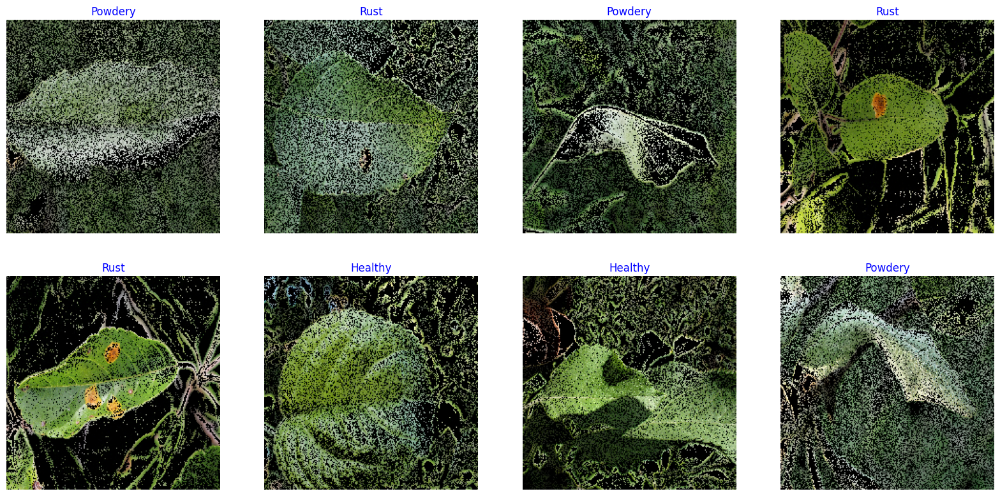

In [ ]:
import matplotlib.pyplot as plt
g_dict = train_gen.class_indices      # defines dictionary {'class': index}
classes = list(g_dict.keys())       # defines list of dictionary's kays (classes), classes names : string
images, labels = next(train_gen)      # get a batch size samples from the generator

plt.figure(figsize=(20, 20))
for i in range(len(images)):
    plt.subplot(4, 4, i + 1)
    image = images[i] / 255       # scales data to range (0 - 255)
    plt.imshow(image)
    index = np.argmax(labels[i])  # get image index
    class_name = classes[index]   # get class of image
    plt.title(class_name, color='blue', fontsize=12)
    plt.axis('off')
plt.show()

In [ ]:
model = Sequential()
model.add(Conv2D(32,                  # Number of filters/Kernels
                     (3,3),               # Size of kernels (3x3 matrix)
                     strides = 1,         # Step size for sliding the kernel across the input (1 pixel at a time).
                     padding = 'same',    # 'Same' ensures that the output feature map has the same dimensions as the input by padding zeros around the input.
                    input_shape = (img_size[0], img_size[1], channels) # Input image shape
                    ))
model.add(Activation('relu'))# Activation function
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
model.add(Dropout(0.2))

model.add(Conv2D(64, (5,5), padding = 'same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
model.add(Dropout(0.2))

model.add(Conv2D(128, (3,3), padding = 'same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
model.add(Dropout(0.3))

model.add(Conv2D(256, (5,5), padding = 'same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
model.add(Dropout(0.3))

model.add(Conv2D(512, (3,3), padding = 'same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size = (2,2), padding = 'same'))
model.add(Dropout(0.3))

# Flattening tensors
model.add(Flatten())

# Fully-Connected Layers
model.add(Dense(2048))
model.add(Activation('relu'))
model.add(Dropout(0.5))

# Output Layer
model.add(Dense(3, activation = 'softmax')) # Classification layer

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 activation (Activation)     (None, 224, 224, 32)      0         
                                                                 
 batch_normalization (Batch  (None, 224, 224, 32)      128       
 Normalization)                                                  
                                                                 
 max_pooling2d (MaxPooling2  (None, 112, 112, 32)      0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 112, 112, 32)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      5

In [ ]:
# Compiling model
model.compile(optimizer = tf.keras.optimizers.RMSprop(0.0001), # 1e-4
              loss = 'categorical_crossentropy', # Ideal for multiclass tasks
              metrics = ['accuracy']) # Evaluation metric

In [ ]:
# Defining an Early Stopping and Model Checkpoints
early_stopping = EarlyStopping(monitor = 'val_accuracy',
                              patience = 10, mode = 'max',
                              restore_best_weights = True)

checkpoint = ModelCheckpoint('best_model.h5',
                            monitor = 'val_accuracy',
                            save_best_only = True)

In [ ]:
history = model.fit(
        train_gen, epochs = 22,
        validation_data = valid_gen,
        callbacks = [early_stopping, checkpoint])

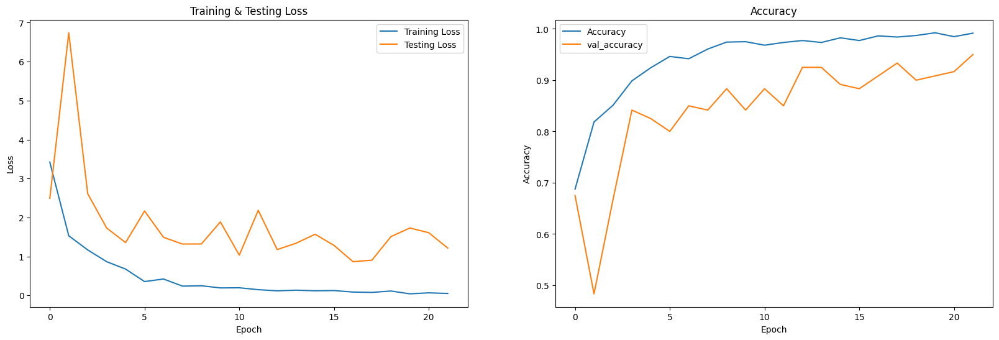

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.metrics import confusion_matrix, classification_report


epochs = [i for i in range(50)]
train_acc = history.history['accuracy']
train_loss = history.history['loss']
test_acc = history.history['val_accuracy']
test_loss = history.history['val_loss']

# Ensure that epochs, train_loss, and test_loss have the same length
min_length = min(len(epochs), len(train_loss), len(test_loss))
epochs = epochs[:min_length]
train_acc = history.history['accuracy']
test_acc = history.history['val_accuracy']
train_loss = train_loss[:min_length]
test_loss = test_loss[:min_length]


# Plot the training and testing loss
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

ax[0].plot(epochs, train_loss, label='Training Loss')
ax[0].plot(epochs, test_loss, label='Testing Loss')
ax[0].set_title('Training & Testing Loss')
ax[0].set_xlabel('Epoch')
ax[0].set_ylabel('Loss')
ax[0].legend()

# Trim the train_acc array to match the length of epochs
train_acc = train_acc[:len(epochs)]

# Assuming you have the necessary arrays: accuracy
# Plot the accuracy
ax[1].plot(epochs, train_acc, label='Accuracy')
ax[1].plot(epochs, test_acc, label='val_accuracy')
ax[1].set_title('Accuracy')
ax[1].set_xlabel('Epoch')
ax[1].set_ylabel('Accuracy')
ax[1].legend()

plt.show()

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

# Evaluate the model on the test data
loss, accuracy = model.evaluate(test_gen)

# Generate predictions for the test data
predictions = model.predict(test_gen)
predicted_labels = np.argmax(predictions, axis=1)  # Convert probabilities to class labels

# Get true labels from the test generator
true_labels = test_gen.classes

# Generate confusion matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)

# Generate classification report
class_report = classification_report(true_labels, predicted_labels)

print("Test Loss:", loss)
print("Test Accuracy:", accuracy)
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

import seaborn as sns

# Plotting the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()
